In [ ]:
mkdir Data

In [ ]:
cd Data

/content/Data


In [ ]:
#Install dataset from git
!git clone https://github.com/MicheleDamian/prostate-gleason-dataset.git

Cloning into 'prostate-gleason-dataset'...
remote: Enumerating objects: 72597, done.
remote: Counting objects: 100% (34/34), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 72597 (delta 20), reused 3 (delta 1), pack-reused 72563
Receiving objects: 100% (72597/72597), 2.31 GiB | 27.59 MiB/s, done.
Resolving deltas: 100% (69/69), done.
Updating files: 100% (72464/72464), done.


In [ ]:
import torch
import torch.nn as nn

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.conv1 = nn.Conv2d(3, 64, 5, padding=2, stride=2)
        self.bn1 = nn.BatchNorm2d(64, momentum=0.9)
        self.conv2 = nn.Conv2d(64, 128, 5, padding=2, stride=2)
        self.bn2 = nn.BatchNorm2d(128, momentum=0.9)
        self.conv3 = nn.Conv2d(128, 256, 5, padding=2, stride=2)
        self.bn3 = nn.BatchNorm2d(256, momentum=0.9)
        self.relu = nn.LeakyReLU(0.2)
        self.fc1 = nn.Linear(256*8*8, 2048)
        self.bn4 = nn.BatchNorm1d(2048, momentum=0.9)
        self.fc_mean = nn.Linear(2048, 128)
        self.fc_logvar = nn.Linear(2048, 128)

    def forward(self, x):
        batch_size = x.size()[0]
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.relu(self.bn2(self.conv2(out)))
        out = self.relu(self.bn3(self.conv3(out)))
        out = out.view(batch_size, -1)
        out = self.relu(self.bn4(self.fc1(out)))
        mean = self.fc_mean(out)
        logvar = self.fc_logvar(out)
        return mean, logvar

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.fc1 = nn.Linear(128, 8*8*256)
        self.bn1 = nn.BatchNorm1d(8*8*256, momentum=0.9)
        self.relu = nn.LeakyReLU(0.2)
        self.deconv1 = nn.ConvTranspose2d(256, 256, 6, stride=2, padding=2)
        self.bn2 = nn.BatchNorm2d(256, momentum=0.9)
        self.deconv2 = nn.ConvTranspose2d(256, 128, 6, stride=2, padding=2)
        self.bn3 = nn.BatchNorm2d(128, momentum=0.9)
        self.deconv3 = nn.ConvTranspose2d(128, 32, 6, stride=2, padding=2)
        self.bn4 = nn.BatchNorm2d(32, momentum=0.9)
        self.deconv4 = nn.ConvTranspose2d(32, 3, 5, stride=1, padding=2)  # 3 output channels for RGB
        self.tanh = nn.Tanh()

    def forward(self, x):
        batch_size = x.size()[0]
        x = self.relu(self.bn1(self.fc1(x)))
        x = x.view(-1, 256, 8, 8)
        x = self.relu(self.bn2(self.deconv1(x)))
        x = self.relu(self.bn3(self.deconv2(x)))
        x = self.relu(self.bn4(self.deconv3(x)))
        x = self.tanh(self.deconv4(x))
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator,self).__init__()
        self.conv1 = nn.Conv2d(3, 32, 5, padding=2, stride=1)
        self.relu = nn.LeakyReLU(0.2)
        self.conv2 = nn.Conv2d(32, 128, 5, padding=2, stride=2)
        self.bn1 = nn.BatchNorm2d(128, momentum=0.9)
        self.conv3 = nn.Conv2d(128, 256, 5, padding=2, stride=2)
        self.bn2 = nn.BatchNorm2d(256, momentum=0.9)
        self.conv4 = nn.Conv2d(256, 256, 5, padding=2, stride=2)
        self.bn3 = nn.BatchNorm2d(256, momentum=0.9)
        self.fc1 = nn.Linear(8*8*256, 512)
        self.bn4 = nn.BatchNorm1d(512, momentum=0.9)
        self.fc2 = nn.Linear(512, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        batch_size = x.size()[0]
        x = self.relu(self.conv1(x))
        x = self.relu(self.bn1(self.conv2(x)))
        x = self.relu(self.bn2(self.conv3(x)))
        x = self.relu(self.bn3(self.conv4(x)))
        x = x.view(-1, 256*8*8)
        x1 = x
        x = self.relu(self.bn4(self.fc1(x)))
        x = self.sigmoid(self.fc2(x))
        return x, x1

class VAE_GAN(nn.Module):
    def __init__(self):
        super(VAE_GAN,self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()
        self.discriminator = Discriminator()
        self.encoder.apply(weights_init)
        self.decoder.apply(weights_init)
        self.discriminator.apply(weights_init)

    def forward(self, x):
        bs = x.size()[0]
        z_mean, z_logvar = self.encoder(x)
        std = z_logvar.mul(0.5).exp_()

        #sampling epsilon from normal distribution
        epsilon = torch.randn(bs, 128).to(device)
        z = z_mean + std * epsilon
        x_tilda = self.decoder(z)

        return z_mean, z_logvar, x_tilda

In [ ]:
from torchvision.utils import make_grid , save_image
import numpy as np
import matplotlib.pyplot as plt
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def show_and_save(file_name,img):
    npimg = np.transpose(img.numpy(),(1,2,0))
    f = "./%s.png" % file_name
    fig = plt.figure(dpi=200)
    fig.suptitle(file_name, fontsize=14, fontweight='bold')
    plt.imshow(npimg)
    plt.imsave(f,npimg)
def plot_loss(loss_list):
    plt.figure(figsize=(10,5))
    plt.title("Loss During Training")
    plt.plot(loss_list,label="Loss")

    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

In [ ]:
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def dataloader(batch_size, train=True):
    dataroot = "/content/Data/"
    transform = transforms.Compose([
        transforms.Resize(64),
        transforms.CenterCrop(64),
        transforms.ToTensor(),
        transforms.Normalize((0.5), (0.5))
    ])

    if train:
        csv_file = '/content/Data/prostate-gleason-dataset/train.csv'
        root_dir = '/content/Data/prostate-gleason-dataset/train'
        shuffle = True
    else:
        csv_file = '/content/Data/prostate-gleason-dataset/test.csv'  # Update this path
        root_dir = '/content/Data/prostate-gleason-dataset/test'  # Update this path
        shuffle = False

    dataset = ProstateGleasonDataset(csv_file=csv_file, root_dir=root_dir, transform=transform)
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)

    return data_loader

In [ ]:
import os
import torch
from torch import Tensor
from pathlib import Path
from typing import List, Optional, Sequence, Union, Any, Callable
from torchvision.datasets.folder import default_loader
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.datasets import CelebA
import zipfile
from PIL import Image
import pandas as pd


# Add your custom dataset class here
class ProstateGleasonDataset(Dataset):
    def __init__(self,csv_file, root_dir, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.annotations = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = os.path.join(self.root_dir, self.annotations.iloc[idx, 0])
        image = Image.open(img_name)

        if self.transform:
            image = self.transform(image)

        #sample = {'image': image, 'class': gleason_class}

        return image, 0

In [ ]:
%pip install tensorboard tensorboardX

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 1.1 MB/s eta 0:00:00


In [ ]:
import os

# Configuration for logging
config = {
    'logging_params': {
        'save_dir': 'runs/vae_gan_1'
    }
}

# Create the TensorBoard log directory
log_dir = config['logging_params']['save_dir']
if not os.path.exists(log_dir):
    os.makedirs(log_dir)


In [ ]:
from tensorboardX import SummaryWriter

# Initialize TensorBoard writer
writer = SummaryWriter('runs/vae_gan_1')

In [ ]:
#import torch

# Create an instance of VAE_GAN()
#gen = VAE_GAN()

# Load the saved state dictionary into the model
#model_path = 'vae_gan_model.pth'  # Replace with the path to your saved model
#gen.load_state_dict(torch.load(model_path))

#gen.to(device)



In [ ]:
def validate_model(val_loader, gen, discrim, criterion, device, gamma):
    gen.eval()
    discrim.eval()

    total_gan_loss = 0
    total_rec_loss = 0
    total_prior_loss = 0

    with torch.no_grad():
        for i, (data, _) in enumerate(data_loader, 0):
            bs = data.size()[0]

            ones_label=Variable(torch.ones(bs,1)).to(device)
            zeros_label=Variable(torch.zeros(bs,1)).to(device)
            zeros_label1=Variable(torch.zeros(64,1)).to(device)  # Check if this size is correct

            # Forward pass through the generator
            datav = Variable(data).to(device)
            mean, logvar, rec_enc = gen(datav)
            z_p = Variable(torch.randn(64,128)).to(device)
            x_p_tilda = gen.decoder(z_p)

            # Forward pass through the discriminator
            output = discrim(datav)[0]
            errD_real = criterion(output, ones_label)
            output = discrim(rec_enc)[0]
            errD_rec_enc = criterion(output, zeros_label)
            output = discrim(x_p_tilda)[0]
            errD_rec_noise = criterion(output, zeros_label1)

            # Calculate losses
            gan_loss = errD_real + errD_rec_enc + errD_rec_noise
            x_l_tilda = discrim(rec_enc)[1]
            x_l = discrim(datav)[1]
            rec_loss = ((x_l_tilda - x_l) ** 2).mean()
            prior_loss = 1 + logvar - mean.pow(2) - logvar.exp()
            prior_loss = (-0.5 * torch.sum(prior_loss)) / torch.numel(mean.data)

            # Accumulate the losses
            total_gan_loss += gan_loss.item()
            total_rec_loss += rec_loss.item()
            total_prior_loss += prior_loss.item()

    avg_gan_loss = total_gan_loss / len(val_loader)
    avg_rec_loss = total_rec_loss / len(val_loader)
    avg_prior_loss = total_prior_loss / len(val_loader)

    return avg_gan_loss, avg_rec_loss, avg_prior_loss

In [ ]:
%reload_ext tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {config['logging_params']['save_dir']}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
!pip install tqdm

Epoch: 10/10, Batch: 1017/1017: 100%|███████████████████████| 10170/10170 [3:50:41<00:00,  1.02it/s]<ipython-input-5-cffaf65f8e8d>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(dpi=200)


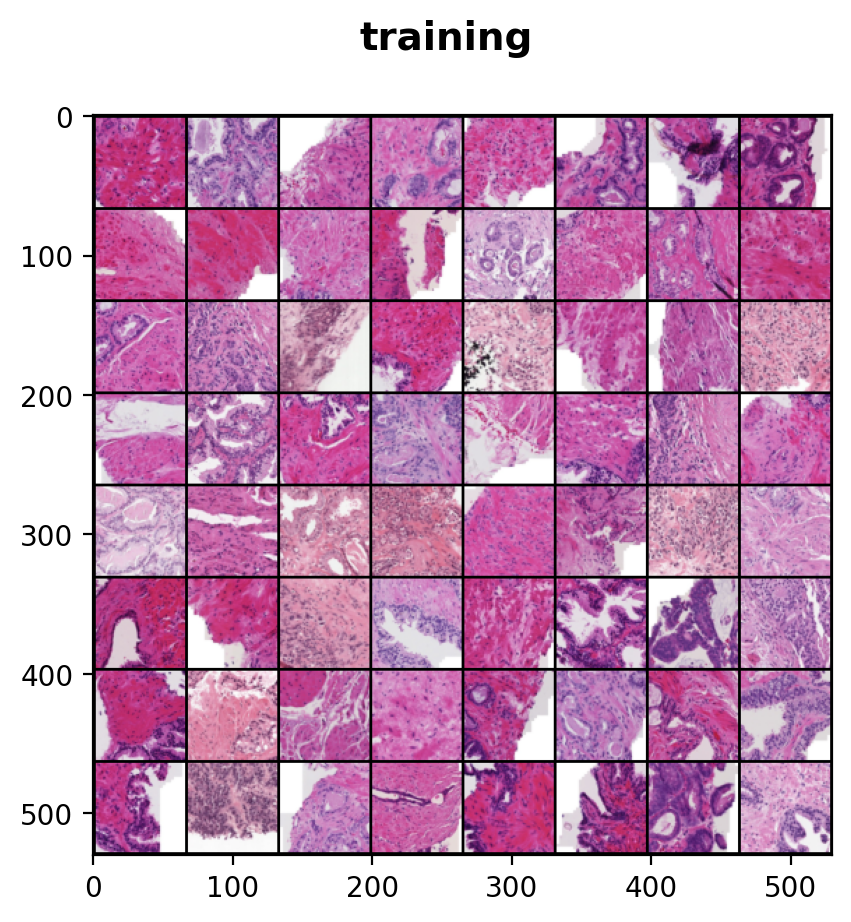

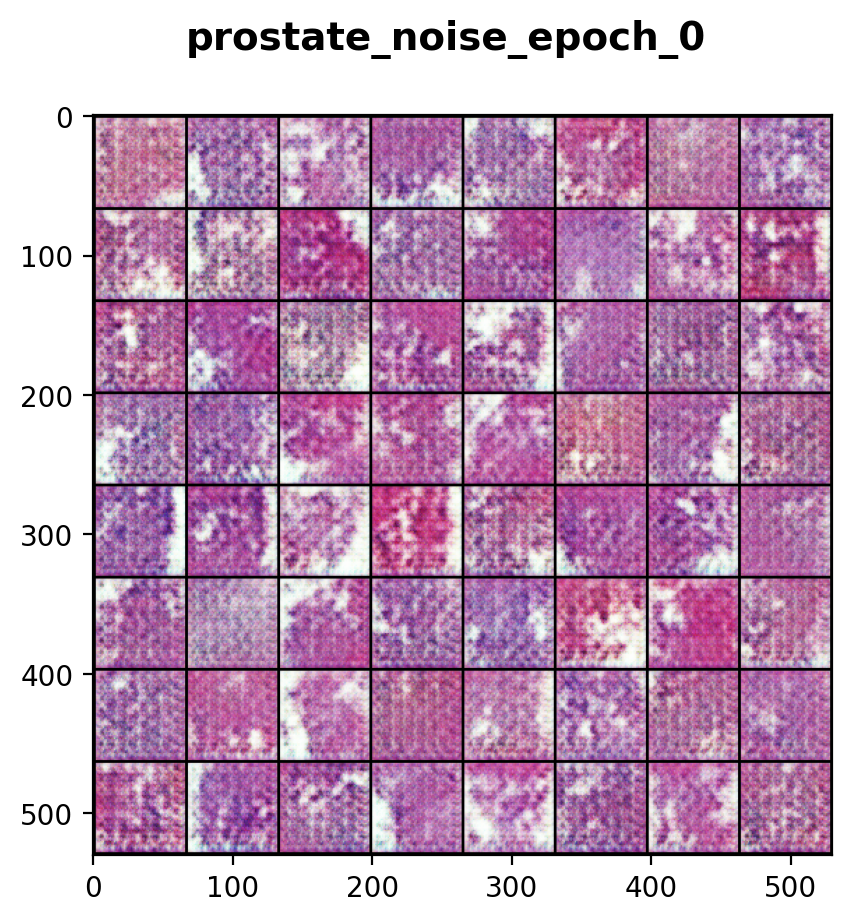

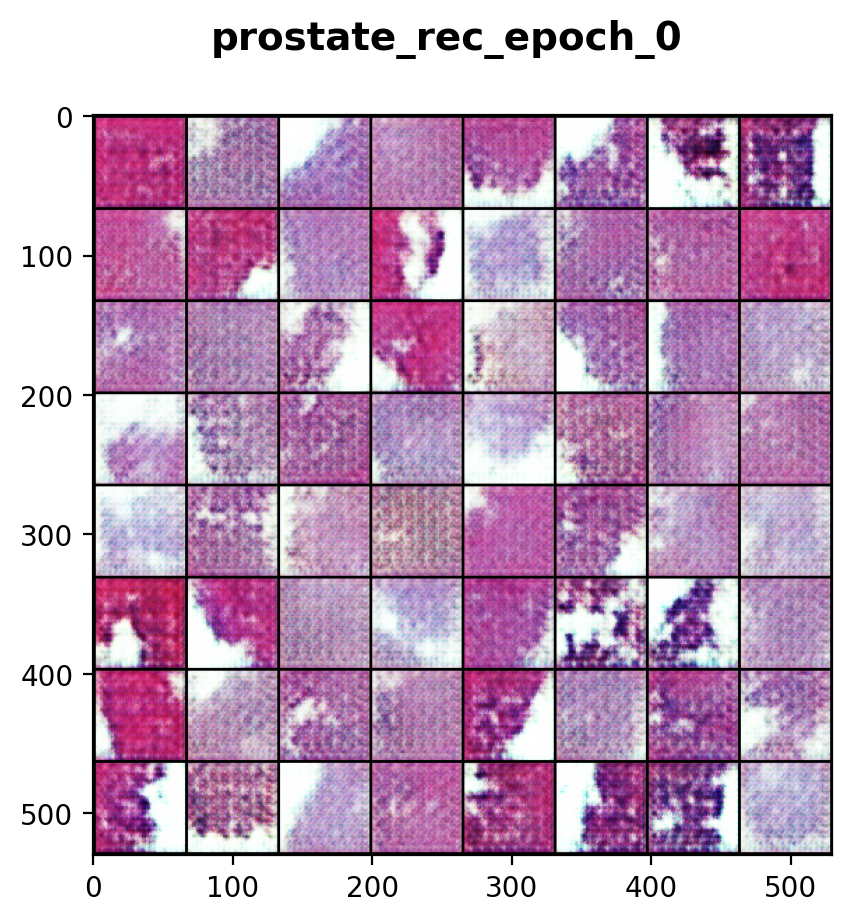

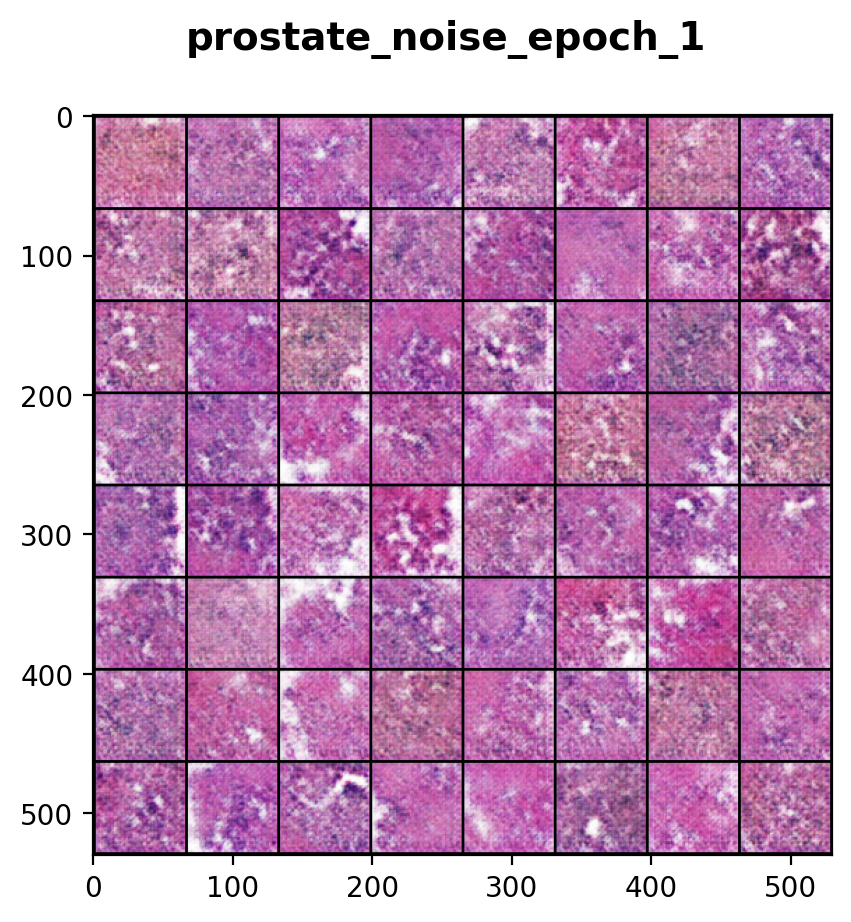

In [ ]:
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from torch.autograd import Variable
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.autograd.set_detect_anomaly(True)

data_loader=dataloader(64)
val_loader=dataloader(64, train=False)
gen=VAE_GAN().to(device)
discrim=Discriminator().to(device)
real_batch = next(iter(data_loader))
show_and_save("training" ,make_grid((real_batch[0]*0.5+0.5).cpu(),8))

epochs=10
lr=3e-4
alpha=0.1
gamma=15

criterion=nn.BCELoss().to(device)
optim_E=torch.optim.RMSprop(gen.encoder.parameters(), lr=lr)
optim_D=torch.optim.RMSprop(gen.decoder.parameters(), lr=lr)
optim_Dis=torch.optim.RMSprop(discrim.parameters(), lr=lr*alpha)
z_fixed=Variable(torch.randn((64,128))).to(device)
x_fixed=Variable(real_batch[0]).to(device)

progress_bar = tqdm(total=len(data_loader) * epochs, ncols=100, desc='Epoch: 0, Batch: 0/0')

for epoch in range(epochs):
  prior_loss_list, gan_loss_list, recon_loss_list = [], [], []
  dis_real_list, dis_fake_list, dis_prior_list = [], [], []

  gen.train()
  discrim.train()

  for i, (data, _) in enumerate(data_loader, 0):
    progress_bar.set_description(f'Epoch: {epoch+1}/{epochs}, Batch: {i+1}/{len(data_loader)}')
    bs = data.size()[0]

    ones_label=Variable(torch.ones(bs,1)).to(device)
    zeros_label=Variable(torch.zeros(bs,1)).to(device)
    zeros_label1=Variable(torch.zeros(64,1)).to(device)
    datav = Variable(data).to(device)
    mean, logvar, rec_enc = gen(datav)
    z_p = Variable(torch.randn(64,128)).to(device)
    x_p_tilda = gen.decoder(z_p)

    output = discrim(datav)[0]
    errD_real = criterion(output, ones_label)
    dis_real_list.append(errD_real.item())
    output = discrim(rec_enc)[0]
    errD_rec_enc = criterion(output, zeros_label)
    dis_fake_list.append(errD_rec_enc.item())
    output = discrim(x_p_tilda)[0]
    errD_rec_noise = criterion(output, zeros_label1)
    dis_prior_list.append(errD_rec_noise.item())
    gan_loss = errD_real + errD_rec_enc + errD_rec_noise
    gan_loss_list.append(gan_loss.item())
    optim_Dis.zero_grad()
    gan_loss.backward(retain_graph=True)
    optim_Dis.step()


    output = discrim(datav)[0]
    errD_real = criterion(output, ones_label)
    output = discrim(rec_enc)[0]
    errD_rec_enc = criterion(output, zeros_label)
    output = discrim(x_p_tilda)[0]
    errD_rec_noise = criterion(output, zeros_label1)
    gan_loss = errD_real + errD_rec_enc + errD_rec_noise


    x_l_tilda = discrim(rec_enc)[1]
    x_l = discrim(datav)[1]
    rec_loss = ((x_l_tilda - x_l) ** 2).mean()
    err_dec = gamma * rec_loss - gan_loss
    recon_loss_list.append(rec_loss.item())
    optim_D.zero_grad()
    err_dec.backward(retain_graph=True)
    optim_D.step()

    mean, logvar, rec_enc = gen(datav)
    x_l_tilda = discrim(rec_enc)[1]
    x_l = discrim(datav)[1]
    rec_loss = ((x_l_tilda - x_l) ** 2).mean()
    prior_loss = 1 + logvar - mean.pow(2) - logvar.exp()
    prior_loss = (-0.5 * torch.sum(prior_loss))/torch.numel(mean.data)
    prior_loss_list.append(prior_loss.item())
    err_enc = prior_loss + 5*rec_loss

    optim_E.zero_grad()
    err_enc.backward(retain_graph=True)
    optim_E.step()

    #if i % 50 == 0:
    #  progress_bar.write('[%d/%d][%d/%d]\tLoss_gan: %.4f\tLoss_prior: %.4f\tRec_loss: %.4f\tdis_real_loss: %0.4f\tdis_fake_loss: %.4f\tdis_prior_loss: %.4f'
    #        % (epoch, epochs, i, len(data_loader),
    #            gan_loss.item(), prior_loss.item(), rec_loss.item(), errD_real.item(), errD_rec_enc.item(), errD_rec_noise.item()))


    # Log losses to TensorBoard
    writer.add_scalar('Loss/GAN', gan_loss.item(), epoch * len(data_loader) + i)
    writer.add_scalar('Loss/Prior', prior_loss.item(), epoch * len(data_loader) + i)
    writer.add_scalar('Loss/Reconstruction', rec_loss.item(), epoch * len(data_loader) + i)
    writer.add_scalar('Loss/Discriminator_Real', errD_real.item(), epoch * len(data_loader) + i)
    writer.add_scalar('Loss/Discriminator_Fake', errD_rec_enc.item(), epoch * len(data_loader) + i)
    writer.add_scalar('Loss/Discriminator_Prior', errD_rec_noise.item(), epoch * len(data_loader) + i)

    # Update the progress bar
    progress_bar.update(1)



  val_gan_loss, val_rec_loss, val_prior_loss = validate_model(val_loader, gen, discrim, criterion, device, gamma)
  writer.add_scalar('Val Loss/GAN', val_gan_loss, epoch)
  writer.add_scalar('Val Loss/Reconstruction', val_rec_loss, epoch)
  writer.add_scalar('Val Loss/Prior', val_prior_loss, epoch)

  b=gen(x_fixed)[2]
  b=b.detach()
  c=gen.decoder(z_fixed)
  c=c.detach()
  show_and_save('prostate_noise_epoch_%d' % epoch ,make_grid((c*0.5+0.5).cpu(),8))
  show_and_save('prostate_rec_epoch_%d' % epoch ,make_grid((b*0.5+0.5).cpu(),8))

writer.close()
plot_loss(prior_loss_list)
plot_loss(recon_loss_list)
plot_loss(gan_loss_list)

In [ ]:
# Define a path to save the model
model_path = 'vae_gan_model.pth'

# Save the model to the specified path
torch.save(gen.state_dict(), model_path)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {config['logging_params']['save_dir']}

<IPython.core.display.Javascript object>

In [ ]:
import os
import pandas as pd
from tensorboard.backend.event_processing import event_accumulator

# Path to your TensorBoard log file
log_file = '/content/runs/vae_gan_1/events.out.tfevents.1702010309-2.2bc241d6ccc9'

# Load the TensorBoard event file
ea = event_accumulator.EventAccumulator(log_file, size_guidance={event_accumulator.SCALARS: 0})
ea.Reload()

# Assuming you want to extract scalar data, modify if you need other data like images, histograms, etc.
scalar_tags = ea.Tags()['scalars']

# Create a DataFrame for each scalar tag
all_data = []
for tag in scalar_tags:
    events = ea.Scalars(tag)
    values = [event.value for event in events]
    steps = [event.step for event in events]
    times = [event.wall_time for event in events]

    tag_df = pd.DataFrame({'step': steps, 'time': times, 'value': values})
    tag_df['tag'] = tag
    all_data.append(tag_df)

# Combine all data into a single DataFrame
combined_df = pd.concat(all_data, ignore_index=True)

# Save as CSV
combined_df.to_csv('/content/tensorboard_data.csv', index=False)

# Save as JSON
combined_df.to_json('/content/tensorboard_data.json', orient='records', lines=True)

# Download the file - Uncomment the lines below if running in Google Colab
# from google.colab import files
# files.download('/content/tensorboard_data.csv')
# files.download('/content/tensorboard_data.json')

In [ ]:
files.download('/content/tensorboard_data.csv')

NameError: ignored

ValueError: ignored

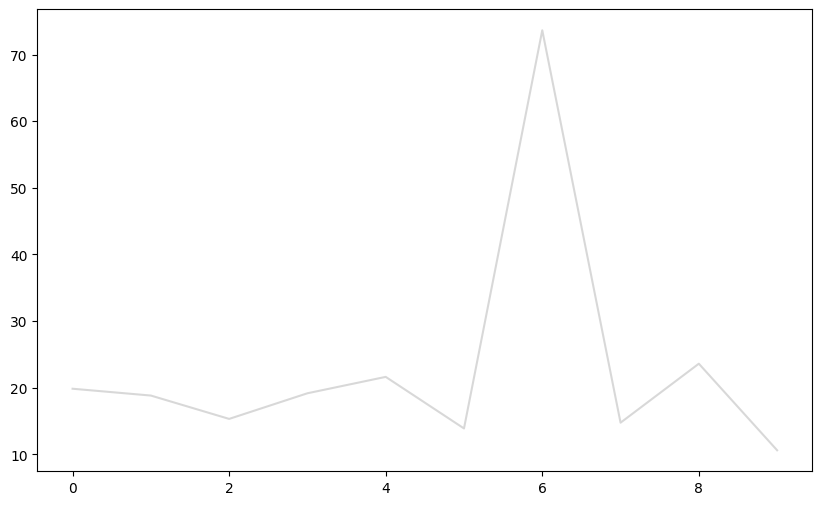

In [ ]:
import os

def smooth(y, window_size):
    box = np.ones(window_size) / window_size
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

# Load the data and group it by 'tag'
df = pd.read_csv('/content/tensorboard_data.csv')
grouped = df.groupby('tag')

window_size = 40  # Adjust as needed

# Create a directory for saved plots
os.makedirs('/content/plots', exist_ok=True)

for tag, group in grouped:
    plt.figure(figsize=(10, 6))

    # Calculate smoothed data
    smoothed_values = smooth(group['value'], window_size)

    # Plot original data in lighter shade
    plt.plot(group['step'], group['value'], alpha=0.3, color='gray')

    # Plot smoothed data
    plt.plot(group['step'], smoothed_values, color='blue')

    # Set plot limits to fit smoothed data
    plt.xlim(min(group['step']), max(group['step']))
    plt.ylim(min(smoothed_values), max(smoothed_values))

    plt.title(f'{tag}')
    plt.xlabel('Step')
    plt.ylabel('Value')
    plt.grid(True)

    # Save plot to file
    filename = f'/content/plots/{tag.replace("/", "_")}_plot.png'
    plt.savefig(filename, bbox_inches='tight')
    plt.close()

# You can now download the plots from the '/content/plots' directory

In [ ]:
tags

array(['Loss/GAN', 'Loss/Prior', 'Loss/Reconstruction',
       'Loss/Discriminator_Real', 'Loss/Discriminator_Fake',
       'Loss/Discriminator_Prior', 'Val_Loss/GAN',
       'Val_Loss/Reconstruction', 'Val_Loss/Prior'], dtype=object)